# Final Project Notebook 2 - TFIDF

## Metadata

```

MacKenzye Leroy (zuf9mc@vriginia.edu)
DS 5001
2 May 2022

Purpose:  Calculate TFIDF for Corpus and save results.
Note: Much of the code in the notebook was originally witten by Dr. Rafael Alvarado and has been editted to fit my particular problem 
```

# Set Up

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import plotly.express as px
import os

In [2]:
home_dir = os.getcwd()
home_dir

'/Users/mackenzyeleroy/Documents/MSDS/DS5001/ETA-Final-Project/FinalProject'

In [3]:
data_home = f"{home_dir}/Data"

parser_lib = f"{home_dir}/lib"
source_files = f'{data_home}/HGWellsAndJulesVerne'
data_prefix = 'wells-verne'

In [4]:
gradient_cmap = 'YlGnBu'  

In [5]:
OHCO = ['book_id', 'chap_id', 'para_num', 'sent_num', 'token_num']

In [6]:
SENTS = OHCO[:4]
PARAS = OHCO[:3]
CHAPS = OHCO[:2]
BOOKS = OHCO[:1]

In [7]:
sns.set()

# Acquire Data

Pull in data created in Notebook 1 (FP_1_TOKENIZE.ipynb)

In [8]:
LIB = pd.read_csv(f"{data_home}/output/{data_prefix}-LIB.csv").set_index(BOOKS)
CORPUS = pd.read_csv(f"{data_home}/output/{data_prefix}-CORPUS.csv").set_index(OHCO)
VOCAB = pd.read_csv(f"{data_home}/output/{data_prefix}-VOCAB.csv").set_index('term_str')
VOCAB = VOCAB.drop('cat_pos', 1) # Drop this column for readability

In [9]:
 LIB.head()

,source_file_path,title,author,chap_regex,book_len,n_chaps
book_id,,,,,,
35,WELLS__35__The_Time_Machine.txt,The Time Machine,"WELLS, H.G",^\s*CHAPTER\s+[[IVXLCM]+\.,32506,17
44278,VERNE__44278__From_the_Earth_to_the_Moon.txt,From the Earth to the Moon,"VERNE, JULES",^\s*CHAPTER\s+[IVXLCM]+\.,40559,28
1355,VERNE__1355__The_Underground_City.txt,The Underground City,"VERNE, JULES",^\s*CHAPTER\s+[IVXLCM]+\.,43662,19
159,WELLS__159__The_Island_of_Doctor_Moreau.txt,The Island of Doctor Moreau,"WELLS, H.G",(INTRODUCTION.)|^\s*CHAPTER\s+[IVXLCM]+\.,43782,23
5230,WELLS__5230__The_Invisible_Man_A_Grotesque_Rom...,The Invisible Man A Grotesque Romance,"WELLS, H.G",^\s*CHAPTER\s+[IVXLCM]+\.,48562,28


In [10]:
 VOCAB.head()

,n,n_chars,p,i,max_pos,n_pos,stop
term_str,,,,,,,
0,3,1,1.688951e-06,19.175441,CD,1,0
000436,1,6,5.629838e-07,20.760403,NNP,1,0
016,1,3,5.629838e-07,20.760403,CD,1,0
05,1,2,5.629838e-07,20.760403,CD,1,0
092,1,3,5.629838e-07,20.760403,CD,1,0


In [11]:
 CORPUS.head()

pos_tuple  pos  \
book_id chap_id para_num sent_num token_num                                
35      1       0        0        0          ('Introduction', 'NN')   NN   
                1        0        0                   ('The', 'DT')   DT   
                                  1                 ('Time', 'NNP')  NNP   
                                  2            ('Traveller', 'NNP')  NNP   
                                  3                 ('(for', 'NNP')  NNP   

                                                token_str      term_str  
book_id chap_id para_num sent_num token_num                              
35      1       0        0        0          Introduction  introduction  
                1        0        0                   The           the  
                                  1                  Time          time  
                                  2             Traveller     traveller  
                                  3                  (for           for

## Gather POS information

In [12]:
pos_info = '/Users/mackenzyeleroy/Documents/MSDS/DS5001/GIT/data/misc/upenn_tagset.txt'
POS = pd.DataFrame([(line.split()[0], ' '.join(line.split()[1:])) 
                    for line in open(pos_info, 'r').readlines()])
POS.columns = ['pos_id', 'pos_def']
POS = POS.set_index('pos_id')
POS['pos_group'] = POS.apply(lambda x: x.name[:2], 1)

In [13]:
VOCAB['max_pos_group'] =  VOCAB.max_pos.apply(lambda x: x[:2])
CORPUS['pos_group'] = CORPUS.pos.apply(lambda x: x[:2])

# Zipf's Law


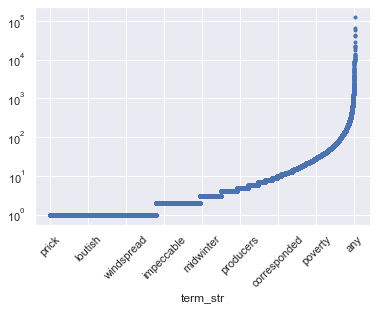

In [14]:
VOCAB.n.sort_values().plot(logy=True, style='.', rot=45);

## Add Term Rank $r$ to `VOCAB`

In [15]:
if 'term_rank' not in VOCAB.columns:
    VOCAB = VOCAB.sort_values('n', ascending=False).reset_index()
    VOCAB.index.name = 'term_rank'
    VOCAB = VOCAB.reset_index()
    VOCAB['term_rank'] = VOCAB['term_rank'] + 1
    VOCAB = VOCAB.set_index('term_str')

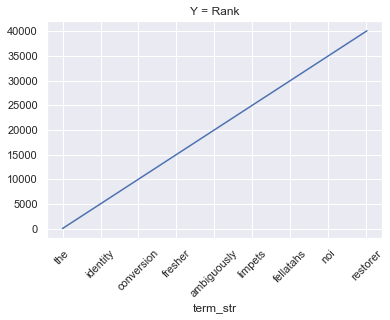

In [16]:
VOCAB.term_rank.plot(logx=False, rot=45, title="Y = Rank");

## Alternate Rank


In [17]:
new_rank = VOCAB.n.value_counts()\
    .sort_index(ascending=False).reset_index().reset_index()\
    .rename(columns={'level_0':'term_rank2', 'index':'n', 'n':'nn'})\
    .set_index('n')

In [18]:
new_rank

,term_rank2,nn
n,,
126415,0,1
67371,1,1
58699,2,1
44406,3,1
41252,4,1
...,...,...
5,757,1493
4,758,2142
3,759,2775


In [19]:
VOCAB['term_rank2'] = VOCAB.n.map(new_rank.term_rank2) + 1

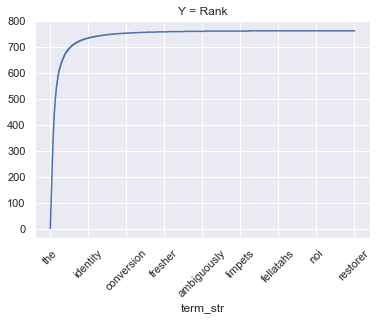

In [20]:
VOCAB.term_rank2.plot(logx=False, rot=45, title="Y = Rank");

## Compute Zipf's $k$

We compute $k$ using both types of rank. Note that this *should* be a constant, but it is not. This is a function of the data size (support) and the fact that Zipf's law is not perfect. 

In [21]:
VOCAB['zipf_k'] = VOCAB.n * VOCAB.term_rank
VOCAB['zipf_k2'] = VOCAB.n * VOCAB.term_rank2

##  Rank and N

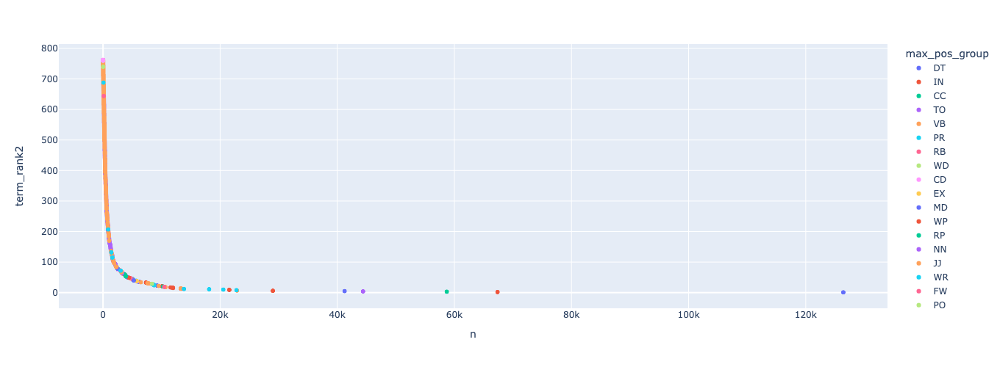

In [22]:
px.scatter(VOCAB.reset_index(), 
           x='n', y='term_rank2', 
           log_y=False, log_x=False,
           hover_name='term_str',
           color='max_pos_group',
           height=500, width=800)

# BOW

In [23]:
bag = CHAPS

In [24]:
BOW = CORPUS.groupby(bag+['term_str']).term_str.count().to_frame('n') 

In [25]:
BOW.head()

n
book_id chap_id term_str    
35      1       a         45
                able       1
                about      9
                above      2
                absent     1

In [26]:
BOW.sample(10)

n
book_id chap_id term_str    
718     9       ing        2
                branch     1
1013    18      nigh       1
16457   2       rubber     1
3526    33      eighty     1
1268    30      secret     1
103     5       espoused   1
6424    4       mists      2
164     39      men        2
1268    4       himalayan  1

In [27]:
BOW.loc[(103,2)].sort_values('n', ascending=False).head(10)

,n
term_str,
the,52
and,40
his,35
he,33
of,32
a,31
was,28
in,27
to,21


## Document-Term Matrix


## Create Count Matrix

In [28]:
DTCM = BOW.n.unstack() #.fillna(0).astype('int')

In [29]:
DTCM.head(10)

term_str          0  000436  016  05  092  0h   1  10  100  1000  ...   â  \
book_id chap_id                                                   ...       
35      1       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        2       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        3       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        4       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        5       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        6       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        7       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        8       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        9       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        10      NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   

term_str         âtrice  æsthetic  æstheticism  éclat  épicier   ō  œdipus  \
book_id chap_id                                                              
35      1           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        2           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        3           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        4           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        5           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        6           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        7           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        8           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        9           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        10          NaN       NaN          NaN    NaN      NaN NaN     NaN   

term_str          α   β  
book_id chap_id          
35      1       NaN NaN  
        2       NaN NaN  
        3       NaN NaN  
        4       NaN NaN  
        5       NaN NaN  
        6       NaN NaN  
        7       NaN NaN  
        8       NaN NaN  
        9       NaN NaN  
        10      NaN NaN  

[10 rows x 40079 columns]

# TFIDF

## Compute TF

In [30]:
tf_method = 'sum' # sum, max, log, double_norm, raw, binary

In [31]:
print('TF method:', tf_method)
if tf_method == 'sum':
    TF = DTCM.T / DTCM.T.sum()
elif tf_method == 'max':
    TF = DTCM.T / DTCM.T.max()
elif tf_method == 'log':
    TF = np.log10(DTCM.T + 1)
elif tf_method == 'raw':
    TF = DTCM.T
elif tf_method == 'bool':
    TF = DTCM.T.astype('bool') #.astype('int')
TF = TF.T

TF method: sum


In [32]:
TF.head()

term_str          0  000436  016  05  092  0h   1  10  100  1000  ...   â  \
book_id chap_id                                                   ...       
35      1       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        2       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        3       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        4       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        5       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   

term_str         âtrice  æsthetic  æstheticism  éclat  épicier   ō  œdipus  \
book_id chap_id                                                              
35      1           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        2           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        3           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        4           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        5           NaN       NaN          NaN    NaN      NaN NaN     NaN   

term_str          α   β  
book_id chap_id          
35      1       NaN NaN  
        2       NaN NaN  
        3       NaN NaN  
        4       NaN NaN  
        5       NaN NaN  

[5 rows x 40079 columns]

## Compute DF

In [33]:
# DF = DTCM[DTCM > 0].count()
DF = DTCM.count() # THIS WORKS IF WE KEPT NULLS IN DTCM

In [34]:
DF.sort_values(ascending=False)

term_str
in                 574
and                574
to                 574
a                  574
the                574
                  ... 
punching             1
punctifera           1
punctilious          1
punctiliously        1
predominatingly      1
Length: 40079, dtype: int64

## Compute IDF

In [35]:
idf_method = 'standard' # standard, max, smooth

In [36]:
N = DTCM.shape[0]

In [37]:
print('IDF method:', idf_method)
if idf_method == 'standard':
    IDF = np.log10(N / DF)
elif idf_method == 'max':
    IDF = np.log10(DF.max() / DF) 
elif idf_method == 'smooth':
    IDF = np.log10((1 + N) / (1 + DF)) + 1

IDF method: standard


In [38]:
IDF

term_str
0          2.457882
000436     2.758912
016        2.758912
05         2.758912
092        2.758912
             ...   
épicier    2.758912
ō          2.758912
œdipus     2.758912
α          2.758912
β          2.156852
Length: 40079, dtype: float64

## Compute TFIDF

In [39]:
TFIDF = TF * IDF

In [40]:
TFIDF.head()

term_str          0  000436  016  05  092  0h   1  10  100  1000  ...   â  \
book_id chap_id                                                   ...       
35      1       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        2       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        3       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        4       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   
        5       NaN     NaN  NaN NaN  NaN NaN NaN NaN  NaN   NaN  ... NaN   

term_str         âtrice  æsthetic  æstheticism  éclat  épicier   ō  œdipus  \
book_id chap_id                                                              
35      1           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        2           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        3           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        4           NaN       NaN          NaN    NaN      NaN NaN     NaN   
        5           NaN       NaN          NaN    NaN      NaN NaN     NaN   

term_str          α   β  
book_id chap_id          
35      1       NaN NaN  
        2       NaN NaN  
        3       NaN NaN  
        4       NaN NaN  
        5       NaN NaN  

[5 rows x 40079 columns]

## Move things to their places

In [41]:
VOCAB['df'] = DF
VOCAB['idf'] = IDF

In [42]:
# VOCAB.head()

In [43]:
BOW['tf'] = TF.stack()
BOW['tfidf'] = TFIDF.stack()

In [44]:
BOW.head()

n        tf     tfidf
book_id chap_id term_str                        
35      1       a         45  0.026611  0.000000
                able       1  0.000591  0.000200
                about      9  0.005322  0.000145
                above      2  0.001183  0.000257
                absent     1  0.000591  0.000805

# Aggregate TFIDF

## Add aggregates to VOCAB

In [45]:
VOCAB['tfidf_mean'] = TFIDF[TFIDF > 0].mean().fillna(0) # EXPLAIN
VOCAB['tfidf_max'] = TFIDF.max()

## DFIDF

In [46]:
VOCAB['dfidf'] = VOCAB.df * VOCAB.idf

In [47]:
VOCAB['dfidf2'] = VOCAB.df/N * VOCAB.idf

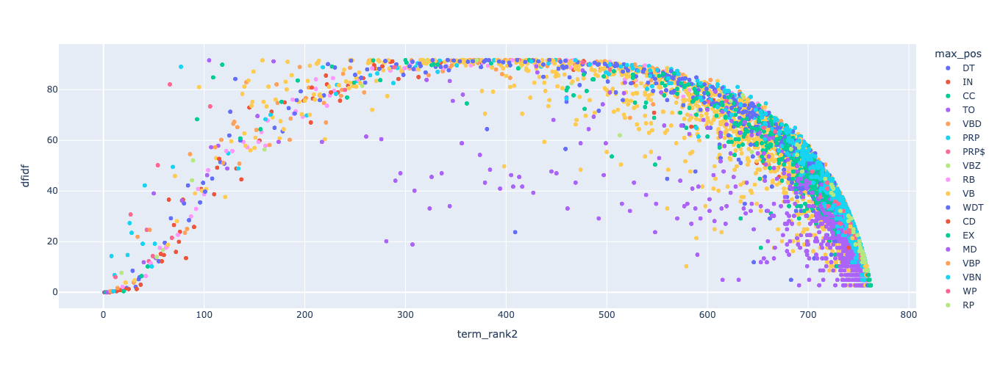

In [48]:
px.scatter(VOCAB.reset_index(), x='term_rank2', y='dfidf', color='max_pos', hover_name='term_str', height=500)

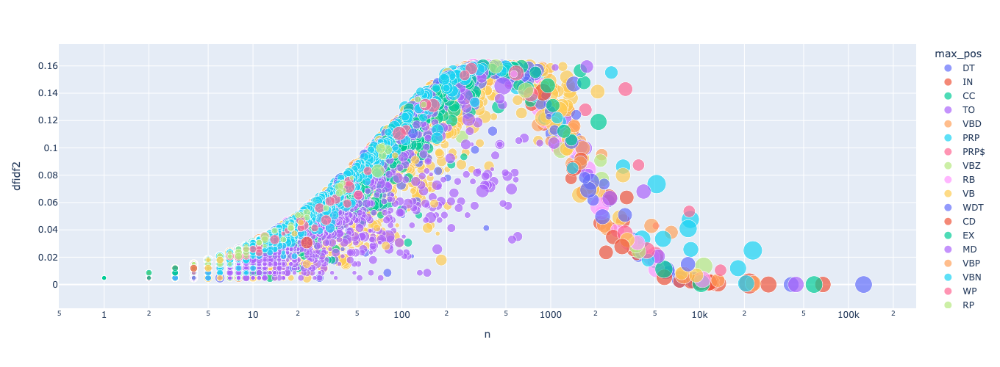

In [49]:
px.scatter(VOCAB.reset_index(), x='n', y='dfidf2', color='max_pos', size="n_pos", hover_name='term_str', log_x=True, width=1200, height=500)

## Observe results

In [50]:
my_cols = "n term_rank2 zipf_k2 max_pos tfidf_mean tfidf_max dfidf".split()

In [51]:
VOCAB[my_cols].sort_values('term_rank2', ascending=True).head(100).style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
the,126415,1,126415,DT,0.000000,0.000000,0.000000
of,67371,2,134742,IN,0.000000,0.000000,0.000000
and,58699,3,176097,CC,0.000000,0.000000,0.000000
to,44406,4,177624,TO,0.000000,0.000000,0.000000
a,41252,5,206260,DT,0.000000,0.000000,0.000000
in,29005,6,174030,IN,0.000000,0.000000,0.000000
was,22877,7,160139,VBD,0.000010,0.000025,0.433916
i,22786,8,182288,PRP,0.000371,0.001562,14.319792
that,21564,9,194076,IN,0.000009,0.000044,0.433916


In [52]:
VOCAB[my_cols].sort_values('tfidf_mean', ascending=False).head(50)\
    .style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
gibbons,2,761,1522,NNS,0.034486,0.034486,2.758912
barman,13,750,9750,NN,0.028174,0.028174,2.758912
ulla,28,735,20580,JJ,0.025040,0.025040,2.758912
nell,173,590,102070,NNP,0.017818,0.026528,14.846575
adye,51,712,36312,NNP,0.016926,0.037187,8.627408
bobo,14,749,10486,NNP,0.016249,0.016249,2.758912
wicksteed,9,754,6786,NNP,0.015876,0.015876,2.758912
helmar,6,757,4542,NNP,0.015871,0.015871,2.758912
henrietta,24,739,17736,NN,0.015716,0.017676,4.915764


In [53]:
VOCAB[my_cols].sort_values('dfidf', ascending=False).head(50)\
    .style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
told,431,369,159039,VBD,0.000287,0.001701,91.706811
friends,455,356,161980,NN,0.000346,0.001655,91.706119
present,428,371,158788,JJ,0.000268,0.001294,91.705446
master,521,322,167762,NN,0.000451,0.003126,91.703378
held,355,420,149100,VBD,0.000231,0.001616,91.703378
different,483,342,165186,JJ,0.000265,0.001427,91.702012
foot,330,442,145860,NN,0.000241,0.001276,91.698597
best,428,371,158788,JJS,0.000248,0.000896,91.698597
covered,321,449,144129,VBN,0.000248,0.000974,91.698597


In [54]:
BOW.sort_values('tfidf', ascending=False).head(20).style.background_gradient(cmap=gradient_cmap, high=.5)

## More Visualizations

#### Rank and TFIDF Mean

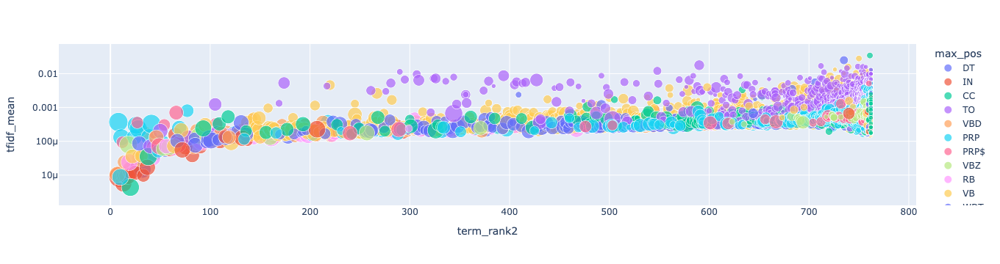

In [55]:
px.scatter(VOCAB.reset_index(), 
           x='term_rank2', y='tfidf_mean', 
           color='max_pos', size='n_pos',
           hover_name='term_str', hover_data=['n','i'],
           log_y=True, log_x=False,
#            height=500, width=800
          )

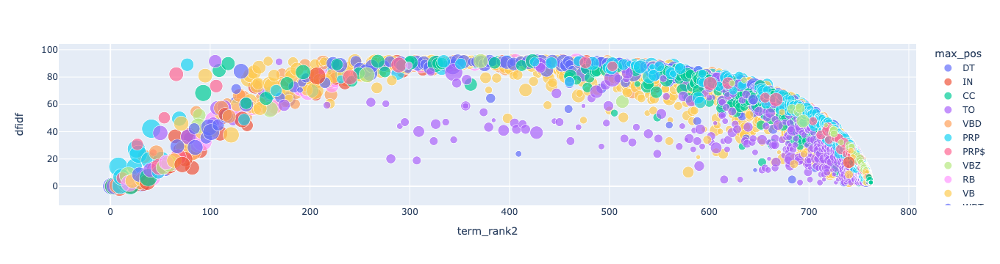

In [56]:
px.scatter(VOCAB.reset_index(), 
           x='term_rank2', y='dfidf', 
           color='max_pos', size='n_pos',
           hover_name='term_str', hover_data=['n','i'],
#            height=500, width=800
          )

## Reduce VOCAB

In [57]:
key_col = 'dfidf'
key_quantile = .9
key_min = VOCAB[key_col].quantile(key_quantile)

In [58]:
SIGS = VOCAB.loc[VOCAB[key_col] >= key_min].sort_values(key_col, ascending=False)

In [59]:
SIGS.shape[0]

4125

In [60]:
SIGS[my_cols].sample(100).style.background_gradient(cmap=gradient_cmap)

,n,term_rank2,zipf_k2,max_pos,tfidf_mean,tfidf_max,dfidf
term_str,,,,,,,
amid,72,691,49752,IN,0.000425,0.001133,60.974843
figures,149,614,91486,NNS,0.000392,0.003625,74.897595
buildings,136,627,85272,NNS,0.000602,0.003705,54.231245
safely,37,726,26862,RB,0.000495,0.001854,41.732721
mute,31,732,22692,NN,0.000476,0.001048,36.729108
lively,38,725,27550,RB,0.000481,0.002170,40.933132
mineral,51,712,36312,JJ,0.000516,0.001249,41.732721
prepared,177,586,103722,VBN,0.000331,0.001133,81.811309
growth,57,706,40242,NN,0.000557,0.003683,43.293938


In [61]:
TFIDF

term_str          0  000436  016  05  092        0h         1  10       100  \
book_id chap_id                                                               
35      1       NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        2       NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        3       NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        4       NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        5       NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
...              ..     ...  ...  ..  ...       ...       ...  ..       ...   
44278   24      NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        25      NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        26      NaN     NaN  NaN NaN  NaN       NaN       NaN NaN       NaN   
        27      NaN     NaN  NaN NaN  NaN  0.003805       NaN NaN  0.002145   
        28      NaN     NaN  NaN NaN  NaN       NaN  0.001979 NaN       NaN   

term_str         1000  ...   â  âtrice  æsthetic  æstheticism  éclat  épicier  \
book_id chap_id        ...                                                      
35      1         NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        2         NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        3         NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        4         NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        5         NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
...               ...  ...  ..     ...       ...          ...    ...      ...   
44278   24        NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        25        NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        26        NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        27        NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   
        28        NaN  ... NaN     NaN       NaN          NaN    NaN      NaN   

term_str          ō  œdipus   α   β  
book_id chap_id                      
35      1       NaN     NaN NaN NaN  
        2       NaN     NaN NaN NaN  
        3       NaN     NaN NaN NaN  
        4       NaN     NaN NaN NaN  
        5       NaN     NaN NaN NaN  
...              ..     ...  ..  ..  
44278   24      NaN     NaN NaN NaN  
        25      NaN     NaN NaN NaN  
        26      NaN     NaN NaN NaN  
        27      NaN     NaN NaN NaN  
        28      NaN     NaN NaN NaN  

[574 rows x 40079 columns]

# Save Work

In [62]:
VOCAB.to_csv(f'{data_home}/output/{data_prefix}-VOCAB2.csv') 
CORPUS.to_csv(f'{data_home}/output/{data_prefix}-CORPUS2.csv')
BOW.to_csv(f'{data_home}/output/{data_prefix}-BOW.csv')
DTCM.to_csv(f'{data_home}/output/{data_prefix}-DTCM.csv')

In [63]:
TFIDF.to_csv(f'{data_home}/output/{data_prefix}-TFIDF.csv')
SIGS.to_csv(f'{data_home}/output/{data_prefix}-SIGS.csv')


In [64]:
TFIDF[SIGS.index].to_csv(f'{data_home}/output/{data_prefix}-TFIDF_REDUCED.csv')